In [24]:
# LIBRERIAS:

# Basicas
import os 
import warnings
warnings.filterwarnings('ignore')
import datetime as dt
import random
import pickle
import json
import csv
import re

import pandas as pd
import numpy as np
import random
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
import seaborn as sns
import scipy.stats as ss
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, LeaveOneOut
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import r2_score

from sklearn.linear_model import LinearRegression, Ridge, Lasso, BayesianRidge, ElasticNet
from sklearn.kernel_ridge import KernelRidge
from sklearn.ensemble import BaggingRegressor, RandomForestRegressor,  GradientBoostingRegressor, AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor, ExtraTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor

In [4]:
os.chdir(os.path.normpath(os.getcwd() + os.sep + os.pardir))
os.getcwd()

'/Users/N716188/Documents/ProjectML/ML_NanoparticulasAu_TBDS/src'

In [5]:
from utils.path import *
from utils.librerias import * 
from utils.funciones import *
from utils.params import *

In [6]:
def del_zeros(data, percent):
    precent_zeros = (data==0).sum()*100/len(data)
    zeros_value_df = pd.DataFrame({'column_name': data.columns,
                                'percent_zeros': precent_zeros}).sort_values('percent_zeros', ascending=False)

    cols_to_drop = zeros_value_df[zeros_value_df['percent_zeros'] > percent].index.values
    print("Cols:", cols_to_drop)

    print("Columnas pre drop:", len(data.columns))

    data.drop(columns=cols_to_drop, inplace=True)

    print("Columnas post drop:", len(data.columns))
    return data

def del_no_vip(data):
    q6q6_avg = data[["q6q6_avg_total", "q6q6_avg_bulk", "q6q6_avg_surf"]]
    data = data.loc[:, ~data.columns.str.startswith('q6q6')]
    data = data.join(q6q6_avg)
    data=data.drop("time", axis=1)
    return data

def create_subdatasets():
    bulk = [i for i in data if  any(re.findall( "bulk|BCN_|FCC|HCP|ICOS|DECA" , i)) | (i.startswith('B')) | ("_B" in i)]
    super = [i for i in data if  any(re.findall( "surf|_S" , i)) | any(map(i.startswith, ["S_","Curve","SCN_"]))]
    totales = [i for i in data if  any(re.findall( "total|Volume|_T|bonds|angle" , i)) |  any(map(i.startswith, ['R',"TCN_"]))]

    data_bulk = data[bulk]
    data_super = data[super]

In [7]:
data = pd.read_csv(DataAu)
data.set_index('ID', inplace = True)

In [8]:
data

,T,tau,time,N_total,N_bulk,N_surface,Volume,R_min,R_max,R_diff,...,q6q6_S14,q6q6_S15,q6q6_S16,q6q6_S17,q6q6_S18,q6q6_S19,q6q6_S20,q6q6_S20+,Total_E,Formation_E
ID,,,,,,,,,,,,,,,,,,,,,
1,273,0.000025,1,1599,1014,585,2.710000e-26,15.5898,19.4516,3.8618,...,0,0,0,0,0,0,0,0,-5908.6345,343.4555
2,273,0.000025,2,1642,1034,608,2.780000e-26,15.3996,24.1755,8.7760,...,0,0,0,0,0,0,0,0,-6035.4034,384.8166
3,273,0.000025,3,4637,3365,1272,7.850000e-26,21.9199,31.0305,9.1106,...,0,0,0,0,0,0,0,0,-17330.1660,800.5040
4,273,0.000025,4,7189,5292,1897,1.220000e-25,23.2542,37.8795,14.6253,...,0,0,0,0,0,0,0,0,-26937.2010,1171.7890
5,273,0.000025,5,11004,8508,2496,1.860000e-25,27.1200,39.7614,12.6415,...,0,0,0,0,0,0,0,0,-41427.9010,1597.7390
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3996,973,0.000250,6,1509,950,559,2.550000e-26,13.8048,23.1729,9.3681,...,0,0,0,0,0,0,0,0,-5346.9589,553.2311
3997,973,0.000250,7,2315,1469,846,3.920000e-26,12.0020,36.7573,24.7553,...,0,0,0,0,0,0,0,0,-8218.1252,833.5248
3998,973,0.000250,8,2764,1905,859,4.680000e-26,18.8611,24.6101,5.7490,...,0,0,0,0,0,0,0,0,-9876.2899,930.9501


In [9]:
data =data.drop([4000],axis=0)
data=data.drop("time", axis=1)

In [11]:
del_zeros(data, 60)

Cols: ['q6q6_B20+' 'TCN_18' 'Curve_141-150' 'Curve_151-160' 'Curve_161-170'
 'Curve_171-180' 'TCN_0' 'q6q6_B20' 'q6q6_B16' 'q6q6_B17' 'q6q6_B18'
 'SCN_20' 'SCN_19' 'SCN_18' 'TCN_19' 'Curve_121-130' 'TCN_20' 'BCN_0'
 'BCN_1' 'BCN_2' 'BCN_3' 'BCN_4' 'SCN_17' 'SCN_16' 'BCN_18' 'BCN_19'
 'BCN_20' 'SCN_0' 'Curve_131-140' 'q6q6_B19' 'Curve_111-120' 'q6q6_S20'
 'q6q6_S16' 'q6q6_S15' 'q6q6_S14' 'Curve_101-110' 'q6q6_T20+' 'q6q6_T20'
 'q6q6_S17' 'q6q6_T18' 'q6q6_T17' 'q6q6_T16' 'q6q6_S19' 'q6q6_T19'
 'q6q6_S18' 'q6q6_S20+' 'Curve_91-100' 'Curve_81-90' 'BCN_5' 'BCN_17'
 'SCN_15' 'TCN_17' 'BCN_6' 'q6q6_B15' 'q6q6_T15' 'BCN_7' 'SCN_14'
 'q6q6_S13' 'ICOS' 'BCN_16' 'TCN_16' 'Curve_71-80' 'SCN_1' 'TCN_1' 'SCN_2'
 'TCN_2' 'BCN_8' 'SCN_3' 'TCN_3' 'BCN_9' 'q6q6_S12' 'SCN_13' 'tau']
Columnas pre drop: 183
Columnas post drop: 110


,T,N_total,N_bulk,N_surface,Volume,R_min,R_max,R_diff,R_avg,R_std,...,q6q6_S4,q6q6_S5,q6q6_S6,q6q6_S7,q6q6_S8,q6q6_S9,q6q6_S10,q6q6_S11,Total_E,Formation_E
ID,,,,,,,,,,,,,,,,,,,,,
1,273,1599,1014,585,2.710000e-26,15.5898,19.4516,3.8618,17.3706,0.6230,...,33,25,18,18,13,18,1,0,-5908.6345,343.4555
2,273,1642,1034,608,2.780000e-26,15.3996,24.1755,8.7760,17.6061,0.9295,...,32,26,26,6,15,12,2,0,-6035.4034,384.8166
3,273,4637,3365,1272,7.850000e-26,21.9199,31.0305,9.1106,25.3692,1.0701,...,95,99,117,123,99,116,51,17,-17330.1660,800.5040
4,273,7189,5292,1897,1.220000e-25,23.2542,37.8795,14.6253,29.7011,2.3732,...,135,147,188,214,227,227,121,64,-26937.2010,1171.7890
5,273,11004,8508,2496,1.860000e-25,27.1200,39.7614,12.6415,34.2831,1.9397,...,154,190,281,308,287,320,156,74,-41427.9010,1597.7390
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,973,1201,683,518,2.030000e-26,11.7580,31.2844,19.5264,16.7874,3.6921,...,2,0,0,0,0,0,0,0,-4230.5430,465.3670
3996,973,1509,950,559,2.550000e-26,13.8048,23.1729,9.3681,17.4079,1.5120,...,3,0,0,1,0,0,0,0,-5346.9589,553.2311
3997,973,2315,1469,846,3.920000e-26,12.0020,36.7573,24.7553,21.2937,4.8536,...,4,0,0,0,0,0,0,0,-8218.1252,833.5248


In [12]:
data["E_atom"] = data["Total_E"]/data["N_total"]

In [13]:
data

,T,N_total,N_bulk,N_surface,Volume,R_min,R_max,R_diff,R_avg,R_std,...,q6q6_S5,q6q6_S6,q6q6_S7,q6q6_S8,q6q6_S9,q6q6_S10,q6q6_S11,Total_E,Formation_E,E_atom
ID,,,,,,,,,,,,,,,,,,,,,
1,273,1599,1014,585,2.710000e-26,15.5898,19.4516,3.8618,17.3706,0.6230,...,25,18,18,13,18,1,0,-5908.6345,343.4555,-3.695206
2,273,1642,1034,608,2.780000e-26,15.3996,24.1755,8.7760,17.6061,0.9295,...,26,26,6,15,12,2,0,-6035.4034,384.8166,-3.675642
3,273,4637,3365,1272,7.850000e-26,21.9199,31.0305,9.1106,25.3692,1.0701,...,99,117,123,99,116,51,17,-17330.1660,800.5040,-3.737366
4,273,7189,5292,1897,1.220000e-25,23.2542,37.8795,14.6253,29.7011,2.3732,...,147,188,214,227,227,121,64,-26937.2010,1171.7890,-3.747003
5,273,11004,8508,2496,1.860000e-25,27.1200,39.7614,12.6415,34.2831,1.9397,...,190,281,308,287,320,156,74,-41427.9010,1597.7390,-3.764804
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,973,1201,683,518,2.030000e-26,11.7580,31.2844,19.5264,16.7874,3.6921,...,0,0,0,0,0,0,0,-4230.5430,465.3670,-3.522517
3996,973,1509,950,559,2.550000e-26,13.8048,23.1729,9.3681,17.4079,1.5120,...,0,0,1,0,0,0,0,-5346.9589,553.2311,-3.543379
3997,973,2315,1469,846,3.920000e-26,12.0020,36.7573,24.7553,21.2937,4.8536,...,0,0,0,0,0,0,0,-8218.1252,833.5248,-3.549946


In [14]:
bulk = [i for i in data if  any(re.findall( "bulk|BCN_|FCC|HCP|ICOS|DECA" , i)) | (i.startswith('B')) | ("_B" in i)]
super = [i for i in data if  any(re.findall( "surf|_S" , i)) | any(map(i.startswith, ["S_","Curve","SCN_"]))]
totales = [i for i in data if  any(re.findall( "total|Volume|_T|bonds|angle" , i)) |  any(map(i.startswith, ['R',"TCN_"]))]

In [15]:
data_bulk = data[bulk]
data_super = data[super]
data_total = data[totales]

# Bulk data

In [24]:
data_bulk

,N_bulk,Avg_bulk,BCN_10,BCN_11,BCN_12,BCN_13,BCN_14,BCN_15,FCC,HCP,...,q6q6_B5,q6q6_B6,q6q6_B7,q6q6_B8,q6q6_B9,q6q6_B10,q6q6_B11,q6q6_B12,q6q6_B13,q6q6_B14
ID,,,,,,,,,,,,,,,,,,,,,
1,1014,12.5552,0,70,434,398,101,11,24,23,...,42,29,29,27,30,17,25,30,7,2
2,1034,12.4952,4,73,470,389,90,8,30,35,...,48,45,40,36,25,26,22,19,10,2
3,3365,12.3902,4,172,1898,1101,178,12,700,376,...,133,150,168,212,224,236,281,959,247,21
4,5292,12.3027,35,191,3407,1445,204,7,1858,823,...,70,87,112,193,204,285,489,2775,732,117
5,8508,12.2159,56,357,5993,1847,238,6,3575,1350,...,89,112,169,307,317,429,645,5029,982,136
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,683,11.8843,55,166,263,160,26,4,0,0,...,1,3,1,0,0,0,0,0,0,0
3996,950,11.8126,82,255,362,188,45,3,0,0,...,2,1,0,0,0,0,0,0,0,0
3997,1469,11.7971,124,411,552,290,66,3,0,0,...,2,1,0,1,1,0,0,0,0,0


In [33]:
prefix = "bulk"
X=data_bulk
y=data[["E_atom"]]

In [31]:
feature_names = X.columns.values
label_names = y.columns.values

In [32]:
print('Feature names: \n', feature_names)
print('Label names: ', label_names)

Feature names: 
 ['N_bulk' 'Avg_bulk' 'BCN_10' 'BCN_11' 'BCN_12' 'BCN_13' 'BCN_14' 'BCN_15'
 'FCC' 'HCP' 'DECA' 'q6q6_avg_bulk' 'q6q6_B0' 'q6q6_B1' 'q6q6_B2'
 'q6q6_B3' 'q6q6_B4' 'q6q6_B5' 'q6q6_B6' 'q6q6_B7' 'q6q6_B8' 'q6q6_B9'
 'q6q6_B10' 'q6q6_B11' 'q6q6_B12' 'q6q6_B13' 'q6q6_B14']
Label names:  ['E_atom']


<Figure size 360x360 with 0 Axes>

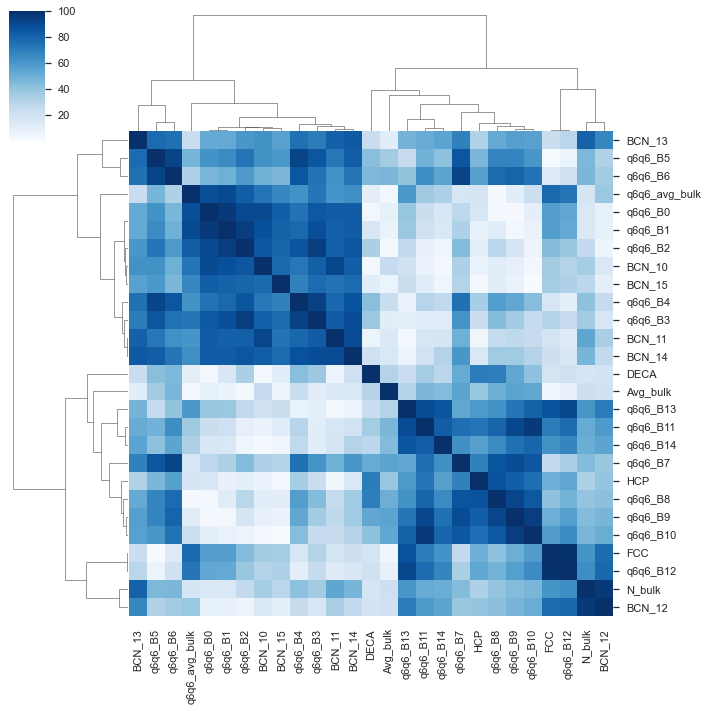

,N_bulk,Avg_bulk,BCN_10,BCN_11,BCN_12,BCN_13,BCN_14,BCN_15,FCC,HCP,...,q6q6_B5,q6q6_B6,q6q6_B7,q6q6_B8,q6q6_B9,q6q6_B10,q6q6_B11,q6q6_B12,q6q6_B13,q6q6_B14
N_bulk,100.000000,21.679553,35.507470,53.850075,96.422721,80.508778,47.299703,28.370541,61.192984,32.231454,...,45.446387,45.865179,44.032184,40.063484,44.118360,46.421215,51.311361,63.933953,60.956552,50.350755
Avg_bulk,21.679553,100.000000,25.373450,14.330343,20.304518,11.057055,15.026538,6.159311,3.797682,39.161142,...,36.107833,46.218107,54.405493,49.736193,54.914962,53.466362,45.919000,7.674788,31.225655,44.494444
BCN_10,35.507470,25.373450,100.000000,91.637636,14.755938,62.326515,82.129474,78.100766,36.247144,7.024184,...,62.532352,49.094317,32.745983,11.198386,8.331156,2.869453,6.949262,31.016358,19.971534,2.777296
BCN_11,53.850075,14.330343,91.637636,100.000000,33.838684,81.228732,89.326951,73.901962,18.325493,4.128103,...,72.834047,62.797605,49.091650,25.049996,27.596139,24.888154,16.511810,11.999323,2.806857,17.646624
BCN_12,96.422721,20.304518,14.755938,33.838684,100.000000,67.086498,26.593372,9.349221,77.341326,39.680660,...,32.026262,36.369882,39.107163,42.103751,46.753744,50.536045,58.690285,78.821882,71.323397,54.284403
BCN_13,80.508778,11.057055,62.326515,81.228732,67.086498,100.000000,84.125730,55.582063,22.840512,31.711968,...,77.525390,75.116214,69.002843,51.973840,56.834215,55.669305,51.086030,28.995322,47.331480,55.077579
BCN_14,47.299703,15.026538,82.129474,89.326951,26.593372,84.125730,100.000000,77.083336,21.678255,14.670579,...,82.528618,73.181044,60.446391,36.678924,36.757688,30.920921,19.318580,15.542966,5.779740,30.655957
BCN_15,28.370541,6.159311,78.100766,73.901962,9.349221,55.582063,77.083336,100.000000,35.690186,2.701484,...,59.532620,46.006480,31.261688,10.815644,6.701278,0.099818,11.193965,32.866551,23.010726,4.744251
FCC,61.192984,3.797682,36.247144,18.325493,77.341326,22.840512,21.678255,35.690186,100.000000,49.561003,...,1.115640,12.956352,26.107897,41.284654,49.945531,58.057407,70.784277,98.847483,86.753998,61.976757
HCP,32.231454,39.161142,7.024184,4.128103,39.680660,31.711968,14.670579,2.701484,49.561003,100.000000,...,45.917693,56.680204,68.820837,86.836996,81.967061,76.076307,73.729290,53.475120,59.228212,56.092964


In [35]:
sns.set()
correlacionados = X.corr(method='spearman').abs().mul(100).astype(float)
plt.figure(figsize=(5,5))
cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=50, as_cmap=True)
cg = sns.clustermap(data = correlacionados, cmap='Blues', metric='correlation')
#cg = sns.clustermap(data = correlated, cmap='Blues', metric='correlation', annot =False, fmt='1g')
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

plt.savefig('fig/correlation_matrix_{}.png'.format(prefix), dpi=300, bbox_inches='tight')
plt.show()
correlacionados

In [37]:
# print correlated features
for c1 in feature_names:
  for c2 in feature_names:
    if c1 != c2 and correlacionados[c1][c2] > 95:
        print(c1, c2)

N_bulk BCN_12
BCN_12 N_bulk
FCC q6q6_B12
q6q6_B0 q6q6_B1
q6q6_B1 q6q6_B0
q6q6_B10 q6q6_B11
q6q6_B11 q6q6_B10
q6q6_B12 FCC


In [38]:
X_scalado = StandardScaler().fit_transform(X)
y_scalado =  StandardScaler().fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X_scalado, y_scalado, test_size=0.2, random_state=42)

In [23]:

def modeling_scoring(model, parameters, X, y, data_set_name):
    
    print(model)

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
    cv = RepeatedKFold(n_splits=5, n_repeats=3, random_state=1)

    modelo_grid = GridSearchCV(estimator= model, 
    param_grid = parameters,
    scoring = "r2", 
    cv = cv, n_jobs= -1)

    start = dt.datetime.now()

    mejor_modelo = modelo_grid.fit(X_train, y_train)

    print('Best Hyperparameters: %s' % mejor_modelo.best_params_)
    print('Best Score: %s' % mejor_modelo.best_score_)
    
    print()
    train_time = (dt.datetime.now() - start).seconds
    print("\tTraining time: %0.3fs" % train_time)
    
    start = dt.datetime.now()
    y_pred = mejor_modelo.predict(X_test)
    predict_time = (dt.datetime.now() - start).seconds 
    print("\tPrediction time: %0.3fs" % predict_time)
    print()

    r2 = round(r2_score(y_test, y_pred), 4)
    print("\tR^2 score:", r2)
    mae = round(mean_absolute_error(y_test, y_pred), 4)
    print("\tMAE score:", mae )
    mse = round(mean_squared_error(y_test, y_pred), 4)
    print("\tMSE score:", mse)
    rmse = round(np.sqrt(mean_squared_error(y_test, y_pred)), 4)
    print("\tRMSE score:", rmse)
    under = 1.0000-round(r2_score(y_test, y_pred), 4)
    print("\tunder: ", under)
    over = 1.0000-round(mejor_modelo.best_score_, 4)
    print("\tover: ", over)

    
    def mean_absolute_percentage_error(y_pred, y_true): 
        y_true, y_pred = np.array(y_true), np.array(y_pred)
        return np.mean(np.abs((y_true - y_pred) / y_true)) * 100
    mape = round(mean_absolute_percentage_error(y_test, y_pred), 4)
    print("\tMAPE score:", mape)


    row=[model.__class__.__name__, data_set_name, X.shape[1], mejor_modelo.get_params(), mejor_modelo.best_score_ , r2, mae, mse, rmse, mape, under, over ]
    guardar_en_fichero(f"data/model_info/model_info_{data_set_name}.csv", row)

    # save the model to disk
    filename = f'model/submodels2/finalized_{model.__class__.__name__}_{data_set_name}_model.sav'
    pickle.dump(mejor_modelo, open(filename, 'wb'))


In [25]:
models = { 
"LinearRegression" :  [LinearRegression(), parameters_linear_regression],

"Ridge" : [Ridge(), parameters_Ridge],

"Lasso" : [Lasso(), parameters_Lasso],

"ElasticNet" : [ElasticNet(), parameters_ElasticNet],


"KernelRidge" : [KernelRidge(), parameters_KernelRidge],

"DecisionTreeRegressor" : [DecisionTreeRegressor(), parameters_DecisionTreeRegressor],

"ExtraTreeRegressor" : [ExtraTreeRegressor(), parameters_ExtraTrees],

"RandomForestRegressor" : [RandomForestRegressor(), parameters_RandomForestRegressor],

"KNeighborsRegressor" : [KNeighborsRegressor(), parameters_KNeighborsRegressor], 

"GradientBoostingRegressor" : [GradientBoostingRegressor(), parameters_GradientBoostingRegressor],

"AdaBoostRegressor" : [AdaBoostRegressor(), parameters_AdaBoostRegressor],

"BaggingRegressor" : [BaggingRegressor(), params_BaggingRegressor],

"SVR" : [SVR(), parameters_SVR]

}

In [65]:
lista=["LinearRegression", "Ridge", "KernelRidge" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

LinearRegression()
Best Hyperparameters: {'copy_X': True, 'fit_intercept': False}
Best Score: 0.6736994142519218

	Training time: 1.000s
	Prediction time: 0.000s

	R^2 score: 0.6988
	MAE score: 0.4618
	MSE score: 0.3004
	RMSE score: 0.5481
	under:  0.3012
	over:  0.32630000000000003
	MAPE score: 830.184
File exist
Ridge()
Best Hyperparameters: {'alpha': 0.5, 'fit_intercept': False, 'max_iter': 100, 'random_state': 0, 'solver': 'svd'}
Best Score: 0.6724543951987745

	Training time: 0.000s
	Prediction time: 0.000s

	R^2 score: 0.697
	MAE score: 0.4629
	MSE score: 0.3022
	RMSE score: 0.5497
	under:  0.30300000000000005
	over:  0.3275
	MAPE score: 773.7933
File exist
KernelRidge()
Best Hyperparameters: {'alpha': 0.1, 'degree': 3, 'gamma': 0.1, 'kernel': 'rbf'}
Best Score: 0.9194775917424408

	Training time: 14.000s
	Prediction time: 0.000s

	R^2 score: 0.9308
	MAE score: 0.1717
	MSE score: 0.069
	RMSE score: 0.2627
	under:  0.06920000000000004
	over:  0.08050000000000002
	MAPE score: 75.91

In [66]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.673699,0.6988,0.4618,0.3004,0.5481,830.1840,0.3012,0.3263
1,Ridge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.672454,0.6970,0.4629,0.3022,0.5497,773.7933,0.3030,0.3275
2,KernelRidge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.919478,0.9308,0.1717,0.0690,0.2627,75.9108,0.0692,0.0805


In [67]:
lista=["Lasso", "ElasticNet", "DecisionTreeRegressor"]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

Lasso()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.622956787095518, tolerance: 2.6205167252450856
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 2.622956787095518, tolerance: 2.6205167252450856
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 3.274130700973501, tolerance: 2.5818700554329235
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/pytho

Best Hyperparameters: {'alpha': 0.01, 'copy_X': True, 'fit_intercept': False, 'max_iter': 100, 'positive': False, 'precompute': True, 'selection': 'cyclic', 'tol': 0.01, 'warm_start': True}
Best Score: 0.6467046945469118

	Training time: 4.000s
	Prediction time: 0.000s

	R^2 score: 0.6682
	MAE score: 0.4849
	MSE score: 0.3309
	RMSE score: 0.5752
	under:  0.3318
	over:  0.35329999999999995
	MAPE score: 2333.5906
File exist
ElasticNet()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 445.1025361605382, tolerance: 0.2500060762409282
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklear

Best Hyperparameters: {'alpha': 0.01, 'copy_X': True, 'fit_intercept': False, 'l1_ratio': 0, 'max_iter': 1000, 'precompute': False, 'random_state': None, 'tol': 0.0001}
Best Score: 0.6590160197741509

	Training time: 9.000s
	Prediction time: 0.000s

	R^2 score: 0.6831
	MAE score: 0.4735
	MSE score: 0.316
	RMSE score: 0.5621
	under:  0.31689999999999996
	over:  0.34099999999999997
	MAPE score: 2442.9469
File exist
DecisionTreeRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expli

Best Hyperparameters: {'max_depth': 5, 'max_features': 'auto', 'max_leaf_nodes': 60, 'min_samples_leaf': 7, 'min_weight_fraction_leaf': 0.1, 'splitter': 'best'}
Best Score: 0.7081757329313756

	Training time: 31.000s
	Prediction time: 0.000s

	R^2 score: 0.7245
	MAE score: 0.4041
	MSE score: 0.2747
	RMSE score: 0.5241
	under:  0.27549999999999997
	over:  0.29179999999999995
	MAPE score: 837.3148
File exist


In [68]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.673699,0.6988,0.4618,0.3004,0.5481,830.1840,0.3012,0.3263
1,Ridge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.672454,0.6970,0.4629,0.3022,0.5497,773.7933,0.3030,0.3275
2,KernelRidge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.919478,0.9308,0.1717,0.0690,0.2627,75.9108,0.0692,0.0805
3,Lasso,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.646705,0.6682,0.4849,0.3309,0.5752,2333.5906,0.3318,0.3533
4,ElasticNet,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.659016,0.6831,0.4735,0.3160,0.5621,2442.9469,0.3169,0.3410
5,DecisionTreeRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.708176,0.7245,0.4041,0.2747,0.5241,837.3148,0.2755,0.2918


In [72]:

parameters_ExtraTrees = {'ccp_alpha' : [0.0 ,0.1, 0.5],
                        'min_samples_leaf': [1, 2],
                        'min_samples_split' : [2, 3, 5]
                        }     

In [74]:
lista=["ExtraTreeRegressor", "RandomForestRegressor" , "KNeighborsRegressor" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

ExtraTreeRegressor()
Best Hyperparameters: {'ccp_alpha': 0.0, 'min_samples_leaf': 2, 'min_samples_split': 5}
Best Score: 0.8500022776961677

	Training time: 1.000s
	Prediction time: 0.000s

	R^2 score: 0.8763
	MAE score: 0.1965
	MSE score: 0.1234
	RMSE score: 0.3512
	under:  0.12370000000000003
	over:  0.15000000000000002
	MAPE score: 706.8695
File exist
RandomForestRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection

Best Hyperparameters: {'bootstrap': False, 'max_features': 0.3, 'min_samples_leaf': 1, 'n_estimators': 500, 'oob_score': False, 'random_state': None}
Best Score: 0.929916671046025

	Training time: 669.000s
	Prediction time: 0.000s

	R^2 score: 0.9415
	MAE score: 0.143
	MSE score: 0.0583
	RMSE score: 0.2415
	under:  0.058499999999999996
	over:  0.07010000000000005
	MAPE score: 1013.8507
File exist
KNeighborsRegressor()
Best Hyperparameters: {'algorithm': 'auto', 'leaf_size': 2, 'n_neighbors': 5}
Best Score: 0.8960733835691068

	Training time: 1.000s
	Prediction time: 0.000s

	R^2 score: 0.9304
	MAE score: 0.1572
	MSE score: 0.0694
	RMSE score: 0.2635
	under:  0.0696
	over:  0.10389999999999999
	MAPE score: 71.4496
File exist


In [75]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.673699,0.6988,0.4618,0.3004,0.5481,830.1840,0.3012,0.3263
1,Ridge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.672454,0.6970,0.4629,0.3022,0.5497,773.7933,0.3030,0.3275
2,KernelRidge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.919478,0.9308,0.1717,0.0690,0.2627,75.9108,0.0692,0.0805
3,Lasso,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.646705,0.6682,0.4849,0.3309,0.5752,2333.5906,0.3318,0.3533
4,ElasticNet,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.659016,0.6831,0.4735,0.3160,0.5621,2442.9469,0.3169,0.3410
5,DecisionTreeRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.708176,0.7245,0.4041,0.2747,0.5241,837.3148,0.2755,0.2918
6,ExtraTreeRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.850002,0.8763,0.1965,0.1234,0.3512,706.8695,0.1237,0.1500
7,RandomForestRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.929917,0.9415,0.1430,0.0583,0.2415,1013.8507,0.0585,0.0701
8,KNeighborsRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.896073,0.9304,0.1572,0.0694,0.2635,71.4496,0.0696,0.1039


In [77]:
lista=["GradientBoostingRegressor", "AdaBoostRegressor", "BaggingRegressor" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

GradientBoostingRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected.

Best Hyperparameters: {'alpha': 0.9, 'learning_rate': 0.1, 'loss': 'huber', 'max_depth': 3, 'min_samples_split': 2, 'n_estimators': 500}
Best Score: 0.9208988748458744

	Training time: 219.000s
	Prediction time: 0.000s

	R^2 score: 0.9351
	MAE score: 0.1603
	MSE score: 0.0647
	RMSE score: 0.2544
	under:  0.06489999999999996
	over:  0.07909999999999995
	MAPE score: 571.3862
File exist
AdaBoostRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d

Best Hyperparameters: {'learning_rate': 1.0, 'loss': 'square', 'n_estimators': 500}
Best Score: 0.8146306158026574

	Training time: 181.000s
	Prediction time: 0.000s

	R^2 score: 0.8191
	MAE score: 0.3721
	MSE score: 0.1804
	RMSE score: 0.4248
	under:  0.18089999999999995
	over:  0.1854
	MAPE score: 415.6751
File exist
BaggingRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed 

Best Hyperparameters: {'bootstrap': False, 'max_features': 8, 'max_samples': 1.0, 'n_estimators': 100}
Best Score: 0.9146970122235805

	Training time: 25.000s
	Prediction time: 0.000s

	R^2 score: 0.928
	MAE score: 0.1832
	MSE score: 0.0718
	RMSE score: 0.2679
	under:  0.07199999999999995
	over:  0.08530000000000004
	MAPE score: 693.6874
File exist


In [79]:
# Load from file
with open("model/submodels2/finalized_Ridge_bulk_model.sav", 'rb') as file:
    pickle_model = pickle.load(file)
    
# Calculate the accuracy score and predict target values
score = pickle_model.score(X_test, y_test)
print("Test score: {0:.2f} %".format(100 * score))


Test score: 69.70 %


In [80]:
from  sklearn.metrics import mean_absolute_percentage_error

In [81]:
mape = pickle_model.mean_absolute_percentage_error(y_test, y_pred)

AttributeError: 'GridSearchCV' object has no attribute 'mean_absolute_percentage_error'

In [82]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.673699,0.6988,0.4618,0.3004,0.5481,830.1840,0.3012,0.3263
1,Ridge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.672454,0.6970,0.4629,0.3022,0.5497,773.7933,0.3030,0.3275
2,KernelRidge,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.919478,0.9308,0.1717,0.0690,0.2627,75.9108,0.0692,0.0805
3,Lasso,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.646705,0.6682,0.4849,0.3309,0.5752,2333.5906,0.3318,0.3533
4,ElasticNet,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.659016,0.6831,0.4735,0.3160,0.5621,2442.9469,0.3169,0.3410
5,DecisionTreeRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.708176,0.7245,0.4041,0.2747,0.5241,837.3148,0.2755,0.2918
6,ExtraTreeRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.850002,0.8763,0.1965,0.1234,0.3512,706.8695,0.1237,0.1500
7,RandomForestRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.929917,0.9415,0.1430,0.0583,0.2415,1013.8507,0.0585,0.0701
8,KNeighborsRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.896073,0.9304,0.1572,0.0694,0.2635,71.4496,0.0696,0.1039
9,GradientBoostingRegressor,bulk,27,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.920899,0.9351,0.1603,0.0647,0.2544,571.3862,0.0649,0.0791


# Data Superficial

In [16]:
data_super

,N_surface,S_100,S_111,S_110,S_311,Curve_1-10,Curve_11-20,Curve_21-30,Curve_31-40,Curve_41-50,...,q6q6_S2,q6q6_S3,q6q6_S4,q6q6_S5,q6q6_S6,q6q6_S7,q6q6_S8,q6q6_S9,q6q6_S10,q6q6_S11
ID,,,,,,,,,,,,,,,,,,,,,
1,585,0,81,119,0,105,229,203,47,1,...,83,49,33,25,18,18,13,18,1,0
2,608,0,65,81,1,111,213,204,64,5,...,72,58,32,26,26,6,15,12,2,0
3,1272,4,204,168,24,306,304,443,171,23,...,85,101,95,99,117,123,99,116,51,17
4,1897,8,178,246,46,383,282,729,403,72,...,117,115,135,147,188,214,227,227,121,64
5,2496,18,204,269,57,451,328,966,585,121,...,135,124,154,190,281,308,287,320,156,74
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,518,0,7,32,2,37,191,189,77,15,...,24,13,2,0,0,0,0,0,0,0
3996,559,0,8,26,8,52,208,197,76,12,...,24,7,3,0,0,1,0,0,0,0
3997,846,1,13,59,6,89,304,293,121,30,...,52,9,4,0,0,0,0,0,0,0


In [17]:
prefix = "super"
X=data_super
y=data[["E_atom"]]

In [18]:
feature_names = X.columns.values
label_names = y.columns.values

In [19]:
print('Feature names: \n', feature_names)
print('Label names: ', label_names)

Feature names: 
 ['N_surface' 'S_100' 'S_111' 'S_110' 'S_311' 'Curve_1-10' 'Curve_11-20'
 'Curve_21-30' 'Curve_31-40' 'Curve_41-50' 'Curve_51-60' 'Curve_61-70'
 'Avg_surf' 'SCN_4' 'SCN_5' 'SCN_6' 'SCN_7' 'SCN_8' 'SCN_9' 'SCN_10'
 'SCN_11' 'SCN_12' 'q6q6_avg_surf' 'q6q6_S0' 'q6q6_S1' 'q6q6_S2' 'q6q6_S3'
 'q6q6_S4' 'q6q6_S5' 'q6q6_S6' 'q6q6_S7' 'q6q6_S8' 'q6q6_S9' 'q6q6_S10'
 'q6q6_S11']
Label names:  ['E_atom']


<Figure size 360x360 with 0 Axes>

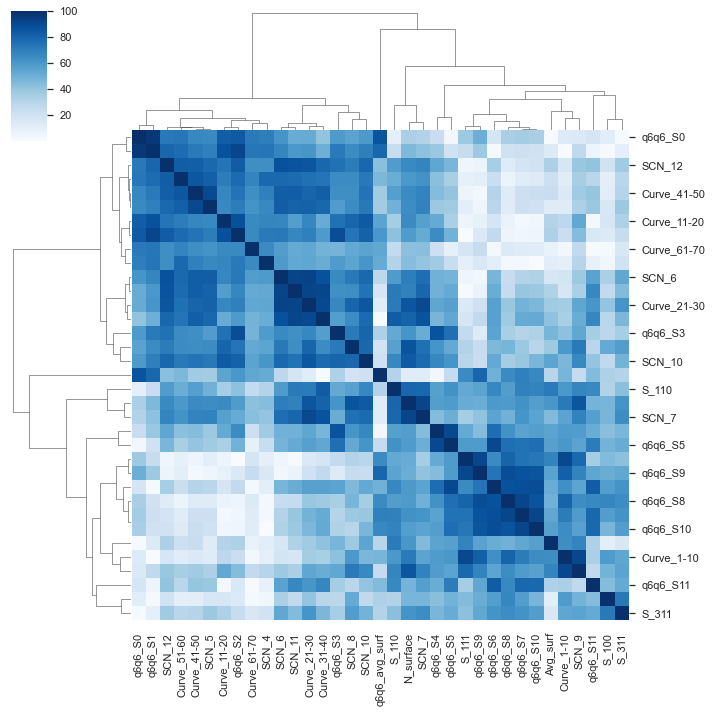

,N_surface,S_100,S_111,S_110,S_311,Curve_1-10,Curve_11-20,Curve_21-30,Curve_31-40,Curve_41-50,...,q6q6_S2,q6q6_S3,q6q6_S4,q6q6_S5,q6q6_S6,q6q6_S7,q6q6_S8,q6q6_S9,q6q6_S10,q6q6_S11
N_surface,100.000000,47.220109,51.107795,79.065288,61.402752,71.704482,64.900578,85.258018,80.403017,64.984617,...,58.456419,61.327029,57.166892,58.397714,59.198796,62.243470,59.001895,50.323595,57.176212,47.395612
S_100,47.220109,100.000000,44.516867,31.453013,72.226168,58.516423,16.793854,39.967246,28.617345,10.883961,...,13.963631,28.342320,42.732938,47.891085,57.358095,57.732997,67.160445,50.464795,46.774448,43.695194
S_111,51.107795,44.516867,100.000000,52.308767,42.159264,90.795520,5.527003,14.420277,16.970260,5.346991,...,0.223417,25.839122,51.799905,58.556039,64.912105,74.335651,79.897398,91.373928,72.604770,35.260346
S_110,79.065288,31.453013,52.308767,100.000000,42.419966,59.749281,35.328818,71.181818,83.055707,56.773105,...,41.541680,52.308655,56.558893,62.503252,66.728915,68.994749,57.507992,54.650657,68.285483,66.111621
S_311,61.402752,72.226168,42.159264,42.419966,100.000000,53.764992,32.621055,61.000045,46.031522,30.425646,...,23.936965,34.947015,46.153289,50.897117,61.724486,61.837897,64.115229,53.236452,57.712334,51.789285
Curve_1-10,71.704482,58.516423,90.795520,59.749281,53.764992,100.000000,27.924296,35.717446,34.434474,14.460642,...,22.485547,41.604756,58.418555,60.098199,63.275558,70.916990,79.717760,81.390445,64.225911,33.390274
Curve_11-20,64.900578,16.793854,5.527003,35.328818,32.621055,27.924296,100.000000,67.217638,50.866851,66.870744,...,87.795566,74.690892,51.725008,33.606891,17.123934,2.338530,6.931579,7.903822,4.210030,2.208087
Curve_21-30,85.258018,39.967246,14.420277,71.181818,61.000045,35.717446,67.217638,100.000000,90.782312,79.661314,...,69.233990,66.498964,53.711245,55.984059,55.786483,48.025010,38.874681,20.711980,45.686660,60.701853
Curve_31-40,80.403017,28.617345,16.970260,83.055707,46.031522,34.434474,50.866851,90.782312,100.000000,81.729732,...,58.651418,57.147083,46.723357,52.923591,55.574511,51.534793,37.248480,25.929862,51.675373,67.202600
Curve_41-50,64.984617,10.883961,5.346991,56.773105,30.425646,14.460642,66.870744,79.661314,81.729732,100.000000,...,74.018973,63.477375,43.484471,40.174719,30.167339,21.569168,12.015941,2.467773,22.795454,39.741810


In [20]:
sns.set()
correlacionados = X.corr(method='spearman').abs().mul(100).astype(float)
plt.figure(figsize=(5,5))
cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=50, as_cmap=True)
cg = sns.clustermap(data = correlacionados, cmap='Blues', metric='correlation')
#cg = sns.clustermap(data = correlated, cmap='Blues', metric='correlation', annot =False, fmt='1g')
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

plt.savefig('fig/correlation_matrix_{}.png'.format(prefix), dpi=300, bbox_inches='tight')
plt.show()
correlacionados

In [21]:
# print correlated features
for c1 in feature_names:
  for c2 in feature_names:
    if c1 != c2 and correlacionados[c1][c2] > 95:
        print(c1, c2)

q6q6_S0 q6q6_S1
q6q6_S1 q6q6_S0


In [22]:
X_scalado = StandardScaler().fit_transform(X)
y_scalado =  StandardScaler().fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X_scalado, y_scalado, test_size=0.2, random_state=42)

In [26]:
lista=["LinearRegression", "Ridge", "KernelRidge" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

LinearRegression()
Best Hyperparameters: {'copy_X': True, 'fit_intercept': False}
Best Score: 0.7963004694094487

	Training time: 1.000s
	Prediction time: 0.000s

	R^2 score: 0.8039
	MAE score: 0.3692
	MSE score: 0.1955
	RMSE score: 0.4422
	under:  0.19610000000000005
	over:  0.2037
	MAPE score: 299.1993
File not exist
Model Info saved
Ridge()
Best Hyperparameters: {'alpha': 0.1, 'fit_intercept': False, 'max_iter': 100, 'random_state': 0, 'solver': 'auto'}
Best Score: 0.7951697910407398

	Training time: 0.000s
	Prediction time: 0.000s

	R^2 score: 0.8022
	MAE score: 0.3715
	MSE score: 0.1973
	RMSE score: 0.4442
	under:  0.19779999999999998
	over:  0.20479999999999998
	MAPE score: 349.1912
File exist
KernelRidge()
Best Hyperparameters: {'alpha': 0.1, 'degree': 3, 'gamma': 0.1, 'kernel': 'rbf'}
Best Score: 0.9165966827762001

	Training time: 14.000s
	Prediction time: 0.000s

	R^2 score: 0.9277
	MAE score: 0.1789
	MSE score: 0.0721
	RMSE score: 0.2686
	under:  0.07230000000000003
	over:  

In [27]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.796300,0.8039,0.3692,0.1955,0.4422,299.1993,0.1961,0.2037
1,Ridge,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.795170,0.8022,0.3715,0.1973,0.4442,349.1912,0.1978,0.2048
2,KernelRidge,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.916597,0.9277,0.1789,0.0721,0.2686,93.8750,0.0723,0.0834


In [28]:
lista=["Lasso", "ElasticNet", "DecisionTreeRegressor"]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

Lasso()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 43.06855994789555, tolerance: 2.592740711360204
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 38.52247611277096, tolerance: 2.5501494722865226
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 40.18956724330451, tolerance: 2.6205167252450856
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python

Best Hyperparameters: {'alpha': 0.01, 'copy_X': True, 'fit_intercept': False, 'max_iter': 100, 'positive': False, 'precompute': False, 'selection': 'cyclic', 'tol': 0.01, 'warm_start': True}
Best Score: 0.748895392049307

	Training time: 4.000s
	Prediction time: 0.000s

	R^2 score: 0.753
	MAE score: 0.427
	MSE score: 0.2463
	RMSE score: 0.4963
	under:  0.247
	over:  0.2511
	MAPE score: 565.0083
File exist
ElasticNet()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 301.8427200121022, tolerance: 0.2500060762409282
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklear

Best Hyperparameters: {'alpha': 0.01, 'copy_X': True, 'fit_intercept': False, 'l1_ratio': 0, 'max_iter': 100, 'precompute': True, 'random_state': None, 'tol': 0.0001}
Best Score: 0.7854010889294488

	Training time: 13.000s
	Prediction time: 0.000s

	R^2 score: 0.7919
	MAE score: 0.3869
	MSE score: 0.2076
	RMSE score: 0.4556
	under:  0.20809999999999995
	over:  0.2146
	MAPE score: 599.0806
File exist
DecisionTreeRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, expli

Best Hyperparameters: {'max_depth': 7, 'max_features': 'auto', 'max_leaf_nodes': 20, 'min_samples_leaf': 7, 'min_weight_fraction_leaf': 0.1, 'splitter': 'best'}
Best Score: 0.6663272706335314

	Training time: 36.000s
	Prediction time: 0.000s

	R^2 score: 0.6318
	MAE score: 0.4808
	MSE score: 0.3672
	RMSE score: 0.606
	under:  0.36819999999999997
	over:  0.3337
	MAPE score: 338.8565
File exist


In [29]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.796300,0.8039,0.3692,0.1955,0.4422,299.1993,0.1961,0.2037
1,Ridge,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.795170,0.8022,0.3715,0.1973,0.4442,349.1912,0.1978,0.2048
2,KernelRidge,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.916597,0.9277,0.1789,0.0721,0.2686,93.8750,0.0723,0.0834
3,Lasso,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.748895,0.7530,0.4270,0.2463,0.4963,565.0083,0.2470,0.2511
4,ElasticNet,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.785401,0.7919,0.3869,0.2076,0.4556,599.0806,0.2081,0.2146
5,DecisionTreeRegressor,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.666327,0.6318,0.4808,0.3672,0.6060,338.8565,0.3682,0.3337


In [31]:
lista=["ExtraTreeRegressor", "RandomForestRegressor" , "KNeighborsRegressor" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

ExtraTreeRegressor()
Best Hyperparameters: {'ccp_alpha': 0.0, 'min_samples_leaf': 2, 'min_samples_split': 2}
Best Score: 0.8059526771465524

	Training time: 2.000s
	Prediction time: 0.000s

	R^2 score: 0.8116
	MAE score: 0.2639
	MSE score: 0.1879
	RMSE score: 0.4335
	under:  0.1884
	over:  0.19399999999999995
	MAPE score: 414.5001
File exist
RandomForestRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection

Best Hyperparameters: {'bootstrap': False, 'max_features': 0.3, 'min_samples_leaf': 1, 'n_estimators': 500, 'oob_score': False, 'random_state': 0}
Best Score: 0.9169102746988568

	Training time: 991.000s
	Prediction time: 0.000s

	R^2 score: 0.9265
	MAE score: 0.1811
	MSE score: 0.0734
	RMSE score: 0.2708
	under:  0.07350000000000001
	over:  0.08309999999999995
	MAPE score: 1072.0573
File exist
KNeighborsRegressor()
Best Hyperparameters: {'algorithm': 'auto', 'leaf_size': 2, 'n_neighbors': 6}
Best Score: 0.8987464884467735

	Training time: 2.000s
	Prediction time: 0.000s

	R^2 score: 0.9056
	MAE score: 0.189
	MSE score: 0.0941
	RMSE score: 0.3068
	under:  0.09440000000000004
	over:  0.10129999999999995
	MAPE score: 112.9098
File exist


In [33]:
lista=["GradientBoostingRegressor", "AdaBoostRegressor", "BaggingRegressor" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

GradientBoostingRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected.

Best Hyperparameters: {'alpha': 0.9, 'learning_rate': 0.1, 'loss': 'huber', 'max_depth': 3, 'min_samples_split': 2, 'n_estimators': 500}
Best Score: 0.9054484563780085

	Training time: 281.000s
	Prediction time: 0.000s

	R^2 score: 0.9101
	MAE score: 0.2094
	MSE score: 0.0897
	RMSE score: 0.2994
	under:  0.08989999999999998
	over:  0.09460000000000002
	MAPE score: 835.633
File exist
AdaBoostRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d

Best Hyperparameters: {'learning_rate': 1.0, 'loss': 'square', 'n_estimators': 500}
Best Score: 0.7756050423521911

	Training time: 224.000s
	Prediction time: 0.000s

	R^2 score: 0.7759
	MAE score: 0.4186
	MSE score: 0.2235
	RMSE score: 0.4727
	under:  0.22409999999999997
	over:  0.22440000000000004
	MAPE score: 422.4597
File exist
BaggingRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed 

Best Hyperparameters: {'bootstrap': False, 'max_features': 8, 'max_samples': 1.0, 'n_estimators': 100}
Best Score: 0.9035891424942902

	Training time: 26.000s
	Prediction time: 0.000s

	R^2 score: 0.9071
	MAE score: 0.2129
	MSE score: 0.0927
	RMSE score: 0.3044
	under:  0.09289999999999998
	over:  0.09640000000000004
	MAPE score: 751.3622
File exist


In [34]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.796300,0.8039,0.3692,0.1955,0.4422,299.1993,0.1961,0.2037
1,Ridge,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.795170,0.8022,0.3715,0.1973,0.4442,349.1912,0.1978,0.2048
2,KernelRidge,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.916597,0.9277,0.1789,0.0721,0.2686,93.8750,0.0723,0.0834
3,Lasso,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.748895,0.7530,0.4270,0.2463,0.4963,565.0083,0.2470,0.2511
4,ElasticNet,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.785401,0.7919,0.3869,0.2076,0.4556,599.0806,0.2081,0.2146
5,DecisionTreeRegressor,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.666327,0.6318,0.4808,0.3672,0.6060,338.8565,0.3682,0.3337
6,ExtraTreeRegressor,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.805953,0.8116,0.2639,0.1879,0.4335,414.5001,0.1884,0.1940
7,RandomForestRegressor,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.916910,0.9265,0.1811,0.0734,0.2708,1072.0573,0.0735,0.0831
8,KNeighborsRegressor,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.898746,0.9056,0.1890,0.0941,0.3068,112.9098,0.0944,0.1013
9,GradientBoostingRegressor,super,35,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.905448,0.9101,0.2094,0.0897,0.2994,835.6330,0.0899,0.0946


# Datos totales

In [35]:
data_total

,N_total,Volume,R_min,R_max,R_diff,R_avg,R_std,R_skew,R_kurt,Avg_total,...,q6q6_T5,q6q6_T6,q6q6_T7,q6q6_T8,q6q6_T9,q6q6_T10,q6q6_T11,q6q6_T12,q6q6_T13,q6q6_T14
ID,,,,,,,,,,,,,,,,,,,,,
1,1599,2.710000e-26,15.5898,19.4516,3.8618,17.3706,0.6230,-0.0435,-0.0731,11.1770,...,67,47,47,40,48,18,25,30,8,2
2,1642,2.780000e-26,15.3996,24.1755,8.7760,17.6061,0.9295,2.0673,9.9355,11.0719,...,74,71,46,51,37,28,22,20,10,2
3,4637,7.850000e-26,21.9199,31.0305,9.1106,25.3692,1.0701,0.3618,1.2311,11.3862,...,232,267,291,311,340,287,298,960,247,21
4,7189,1.220000e-25,23.2542,37.8795,14.6253,29.7011,2.3732,0.1431,-0.1013,11.3198,...,217,275,326,420,431,406,553,2784,732,117
5,11004,1.860000e-25,27.1200,39.7614,12.6415,34.2831,1.9397,-0.3849,-0.0888,11.3851,...,279,393,477,594,637,585,719,5036,983,136
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,1201,2.030000e-26,11.7580,31.2844,19.5264,16.7874,3.6921,1.9096,3.6830,10.2931,...,1,3,1,0,0,0,0,0,0,0
3996,1509,2.550000e-26,13.8048,23.1729,9.3681,17.4079,1.5120,0.9028,1.4812,10.5010,...,2,1,1,0,0,0,0,0,0,0
3997,2315,3.920000e-26,12.0020,36.7573,24.7553,21.2937,4.8536,0.9600,1.0361,10.5114,...,2,1,0,1,1,0,0,0,0,0


In [39]:
prefix = "total"
X=data_total
y=data[["E_atom"]]

In [40]:
feature_names = X.columns.values
label_names = y.columns.values

In [41]:
print('Feature names: \n', feature_names)
print('Label names: ', label_names)

Feature names: 
 ['N_total' 'Volume' 'R_min' 'R_max' 'R_diff' 'R_avg' 'R_std' 'R_skew'
 'R_kurt' 'Avg_total' 'TCN_4' 'TCN_5' 'TCN_6' 'TCN_7' 'TCN_8' 'TCN_9'
 'TCN_10' 'TCN_11' 'TCN_12' 'TCN_13' 'TCN_14' 'TCN_15' 'Avg_bonds'
 'Std_bonds' 'Max_bonds' 'Min_bonds' 'N_bonds' 'angle_avg' 'angle_std'
 'q6q6_avg_total' 'q6q6_T0' 'q6q6_T1' 'q6q6_T2' 'q6q6_T3' 'q6q6_T4'
 'q6q6_T5' 'q6q6_T6' 'q6q6_T7' 'q6q6_T8' 'q6q6_T9' 'q6q6_T10' 'q6q6_T11'
 'q6q6_T12' 'q6q6_T13' 'q6q6_T14']
Label names:  ['E_atom']


<Figure size 360x360 with 0 Axes>

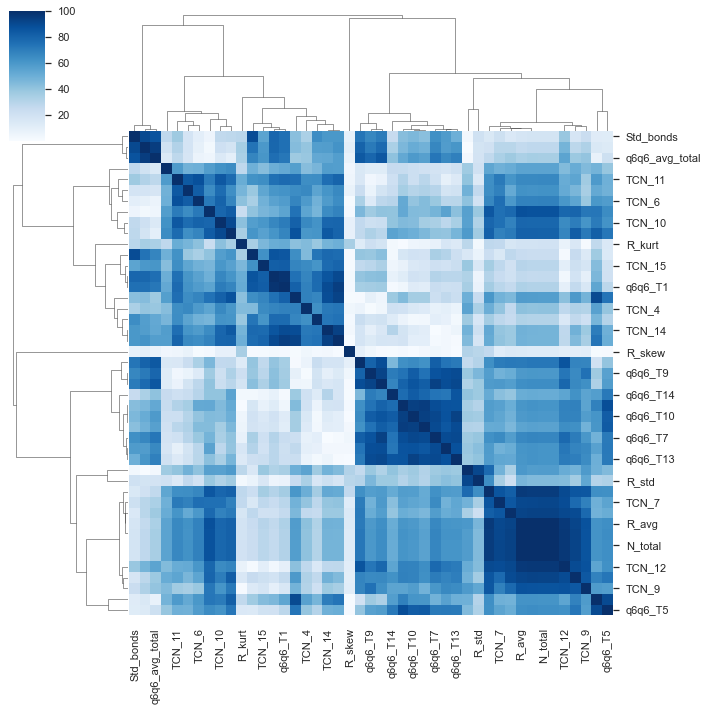

,N_total,Volume,R_min,R_max,R_diff,R_avg,R_std,R_skew,R_kurt,Avg_total,...,q6q6_T5,q6q6_T6,q6q6_T7,q6q6_T8,q6q6_T9,q6q6_T10,q6q6_T11,q6q6_T12,q6q6_T13,q6q6_T14
N_total,100.000000,99.999781,93.224533,95.039665,57.872062,99.918804,44.679485,12.880737,19.259389,92.246091,...,63.603478,61.282674,67.032625,61.302362,59.460242,59.729614,55.145648,64.098429,61.272752,50.875970
Volume,99.999781,100.000000,93.225854,95.037549,57.868717,99.918773,44.677352,12.870317,19.255163,92.249110,...,63.604694,61.283977,67.033911,61.308349,59.465810,59.731492,55.145902,64.101052,61.275072,50.878050
R_min,93.224533,93.225854,100.000000,81.813418,33.796501,92.497699,21.534677,14.200729,16.746366,89.718216,...,50.554239,50.359243,57.582380,50.420656,50.640318,48.623614,45.765175,57.273181,52.440680,39.576944
R_max,95.039665,95.037549,81.813418,100.000000,77.555057,95.799063,63.844648,26.250189,27.243789,85.400206,...,63.260059,57.624117,62.556823,58.542885,57.261781,57.219602,51.229732,58.235137,57.944840,51.265093
R_diff,57.872062,57.868717,33.796501,77.555057,100.000000,59.725543,91.097422,31.449937,28.501397,48.404597,...,44.906323,34.458784,37.507299,38.927117,38.528431,37.218178,31.271636,31.713522,37.598078,40.405220
R_avg,99.918804,99.918773,92.497699,95.799063,59.725543,100.000000,46.610857,13.581952,18.977091,91.824186,...,63.431564,60.560608,66.173770,61.005556,59.230759,59.209564,54.339276,63.326253,60.848591,50.751817
R_std,44.679485,44.677352,21.534677,63.844648,91.097422,46.610857,100.000000,29.123364,2.665593,35.970276,...,32.501572,30.801357,39.265344,42.422759,45.877918,35.985686,30.560370,37.787073,40.289156,37.855806
R_skew,12.880737,12.870317,14.200729,26.250189,31.449937,13.581952,29.123364,100.000000,34.438938,10.409742,...,1.339326,2.229082,4.112744,3.078171,4.188222,0.478793,3.064326,1.196799,0.708023,1.120829
R_kurt,19.259389,19.255163,16.746366,27.243789,28.501397,18.977091,2.665593,34.438938,100.000000,15.271901,...,14.689596,0.469348,7.489518,16.230123,21.605142,4.878972,5.594637,18.093402,13.684481,2.499135
Avg_total,92.246091,92.249110,89.718216,85.400206,48.404597,91.824186,35.970276,10.409742,15.271901,100.000000,...,72.858943,68.970803,70.857389,67.810579,65.254035,68.011118,62.900466,65.752745,70.100131,62.434646


In [42]:
sns.set()
correlacionados = X.corr(method='spearman').abs().mul(100).astype(float)
plt.figure(figsize=(5,5))
cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=50, as_cmap=True)
cg = sns.clustermap(data = correlacionados, cmap='Blues', metric='correlation')
#cg = sns.clustermap(data = correlated, cmap='Blues', metric='correlation', annot =False, fmt='1g')
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

plt.savefig('fig/correlation_matrix_{}.png'.format(prefix), dpi=300, bbox_inches='tight')
plt.show()
correlacionados

In [43]:
# print correlated features
for c1 in feature_names:
  for c2 in feature_names:
    if c1 != c2 and correlacionados[c1][c2] > 95:
        print(c1, c2)

N_total Volume
N_total R_max
N_total R_avg
N_total TCN_12
N_total N_bonds
Volume N_total
Volume R_max
Volume R_avg
Volume TCN_12
Volume N_bonds
R_max N_total
R_max Volume
R_max R_avg
R_avg N_total
R_avg Volume
R_avg R_max
R_avg TCN_12
R_avg N_bonds
TCN_12 N_total
TCN_12 Volume
TCN_12 R_avg
TCN_12 N_bonds
N_bonds N_total
N_bonds Volume
N_bonds R_avg
N_bonds TCN_12
q6q6_T0 q6q6_T1
q6q6_T1 q6q6_T0


In [44]:
X_scalado = StandardScaler().fit_transform(X)
y_scalado =  StandardScaler().fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X_scalado, y_scalado, test_size=0.2, random_state=42)

In [45]:
lista=["LinearRegression", "Ridge", "KernelRidge" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

LinearRegression()
Best Hyperparameters: {'copy_X': True, 'fit_intercept': False}
Best Score: 0.9306517844931478

	Training time: 1.000s
	Prediction time: 0.000s

	R^2 score: 0.9363
	MAE score: 0.1862
	MSE score: 0.0635
	RMSE score: 0.252
	under:  0.06369999999999998
	over:  0.06930000000000003
	MAPE score: 82.826
File not exist
Model Info saved
Ridge()
Best Hyperparameters: {'alpha': 0.1, 'fit_intercept': False, 'max_iter': 100, 'random_state': 0, 'solver': 'auto'}
Best Score: 0.9305693828749163

	Training time: 0.000s
	Prediction time: 0.000s

	R^2 score: 0.9365
	MAE score: 0.185
	MSE score: 0.0633
	RMSE score: 0.2517
	under:  0.0635
	over:  0.06940000000000002
	MAPE score: 64.2242
File exist
KernelRidge()
Best Hyperparameters: {'alpha': 0.1, 'degree': 3, 'gamma': 0.01, 'kernel': 'polynomial'}
Best Score: 0.9615783651244865

	Training time: 15.000s
	Prediction time: 0.000s

	R^2 score: 0.9664
	MAE score: 0.1172
	MSE score: 0.0335
	RMSE score: 0.1829
	under:  0.03359999999999996
	over

In [46]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930652,0.9363,0.1862,0.0635,0.2520,82.8260,0.0637,0.0693
1,Ridge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930569,0.9365,0.1850,0.0633,0.2517,64.2242,0.0635,0.0694
2,KernelRidge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.961578,0.9664,0.1172,0.0335,0.1829,77.2667,0.0336,0.0384


In [47]:
lista=["Lasso", "ElasticNet", "DecisionTreeRegressor"]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

Lasso()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 10.155440294873983, tolerance: 2.5629634582993552
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.246438629773962, tolerance: 2.544048210588954
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 11.246438629773962, tolerance: 2.544048210588954
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/pyth

Best Hyperparameters: {'alpha': 0.01, 'copy_X': True, 'fit_intercept': False, 'max_iter': 100, 'positive': False, 'precompute': False, 'selection': 'cyclic', 'tol': 0.01, 'warm_start': True}
Best Score: 0.9121469630346365

	Training time: 6.000s
	Prediction time: 0.000s

	R^2 score: 0.9206
	MAE score: 0.2133
	MSE score: 0.0792
	RMSE score: 0.2814
	under:  0.07940000000000003
	over:  0.08789999999999998
	MAPE score: 531.4094
File exist
ElasticNet()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: ConvergenceWarning: Objective did not converge. You might want to increase the number of iterations. Duality gap: 117.53213002622122, tolerance: 0.2500060762409282
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/linear_model/_coordinate_descent.py:634: UserWarning: Coordinate descent without L1 regularization may lead to unexpected results and is discouraged. Set l1_ratio > 0 to add L1 regularization.
  model = cd_fast.enet_coordinate_descent_gram(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklea

Best Hyperparameters: {'alpha': 0.01, 'copy_X': True, 'fit_intercept': False, 'l1_ratio': 0, 'max_iter': 100, 'precompute': True, 'random_state': None, 'tol': 0.0001}
Best Score: 0.9249872694107424

	Training time: 16.000s
	Prediction time: 0.000s

	R^2 score: 0.9322
	MAE score: 0.1929
	MSE score: 0.0676
	RMSE score: 0.2599
	under:  0.06779999999999997
	over:  0.07499999999999996
	MAPE score: 575.1203
File exist
DecisionTreeRegressor()


citly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be removed in 1.3. To keep the past behaviour, explicitly set `max_features=1.0'`.
  warnings.warn(
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/tree/_classes.py:306: FutureWarning: `max_features='auto'` has been deprecated in 1.1 and will be r

Best Hyperparameters: {'max_depth': 5, 'max_features': 'auto', 'max_leaf_nodes': None, 'min_samples_leaf': 1, 'min_weight_fraction_leaf': 0.1, 'splitter': 'best'}
Best Score: 0.6931306653226318

	Training time: 50.000s
	Prediction time: 0.000s

	R^2 score: 0.7344
	MAE score: 0.3966
	MSE score: 0.2648
	RMSE score: 0.5146
	under:  0.26559999999999995
	over:  0.30689999999999995
	MAPE score: 216.4866
File exist


In [48]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930652,0.9363,0.1862,0.0635,0.2520,82.8260,0.0637,0.0693
1,Ridge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930569,0.9365,0.1850,0.0633,0.2517,64.2242,0.0635,0.0694
2,KernelRidge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.961578,0.9664,0.1172,0.0335,0.1829,77.2667,0.0336,0.0384
3,Lasso,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.912147,0.9206,0.2133,0.0792,0.2814,531.4094,0.0794,0.0879
4,ElasticNet,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.924987,0.9322,0.1929,0.0676,0.2599,575.1203,0.0678,0.0750
5,DecisionTreeRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.693131,0.7344,0.3966,0.2648,0.5146,216.4866,0.2656,0.3069


In [49]:
lista=["ExtraTreeRegressor", "RandomForestRegressor" , "KNeighborsRegressor" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

ExtraTreeRegressor()
Best Hyperparameters: {'ccp_alpha': 0.0, 'min_samples_leaf': 2, 'min_samples_split': 5}
Best Score: 0.9130217193639142

	Training time: 2.000s
	Prediction time: 0.000s

	R^2 score: 0.9355
	MAE score: 0.1215
	MSE score: 0.0643
	RMSE score: 0.2537
	under:  0.0645
	over:  0.08699999999999997
	MAPE score: 801.7072
File exist
RandomForestRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection/_validation.py:686: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  estimator.fit(X_train, y_train, **fit_params)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/model_selection

Best Hyperparameters: {'bootstrap': False, 'max_features': 0.5, 'min_samples_leaf': 1, 'n_estimators': 500, 'oob_score': False, 'random_state': 0}
Best Score: 0.9673423384971774

	Training time: 1417.000s
	Prediction time: 0.000s

	R^2 score: 0.9796
	MAE score: 0.078
	MSE score: 0.0203
	RMSE score: 0.1426
	under:  0.020399999999999974
	over:  0.03269999999999995
	MAPE score: 698.2466
File exist
KNeighborsRegressor()
Best Hyperparameters: {'algorithm': 'auto', 'leaf_size': 2, 'n_neighbors': 5}
Best Score: 0.9444861985044777

	Training time: 3.000s
	Prediction time: 0.000s

	R^2 score: 0.9608
	MAE score: 0.1178
	MSE score: 0.0391
	RMSE score: 0.1978
	under:  0.03920000000000001
	over:  0.055499999999999994
	MAPE score: 92.7476
File exist


In [51]:
lista=["GradientBoostingRegressor", "AdaBoostRegressor", "BaggingRegressor" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

GradientBoostingRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_gb.py:570: DataConversionWarning: A column-vector y was passed when a 1d array was expected.

Best Hyperparameters: {'alpha': 0.9, 'learning_rate': 0.1, 'loss': 'squared_error', 'max_depth': 3, 'min_samples_split': 2, 'n_estimators': 500}
Best Score: 0.96196732610513

	Training time: 449.000s
	Prediction time: 0.000s

	R^2 score: 0.9691
	MAE score: 0.1111
	MSE score: 0.0308
	RMSE score: 0.1756
	under:  0.03090000000000004
	over:  0.038000000000000034
	MAPE score: 778.5616
File exist
AdaBoostRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/utils/validation.py:1111: DataConversionWarning: A column-vector y was passed when a 1d

Best Hyperparameters: {'learning_rate': 0.01, 'loss': 'exponential', 'n_estimators': 1000}
Best Score: 0.849620754427287

	Training time: 361.000s
	Prediction time: 0.000s

	R^2 score: 0.8493
	MAE score: 0.337
	MSE score: 0.1503
	RMSE score: 0.3877
	under:  0.15069999999999995
	over:  0.15039999999999998
	MAPE score: 1097.3607
File exist
BaggingRegressor()


/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return column_or_1d(y, warn=True)
/Users/N716188/Library/Python/3.8/lib/python/site-packages/sklearn/ensemble/_bagging.py:470: DataConversionWarning: A column-vector y was passed 

Best Hyperparameters: {'bootstrap': False, 'max_features': 8, 'max_samples': 1.0, 'n_estimators': 100}
Best Score: 0.9453136890668773

	Training time: 30.000s
	Prediction time: 0.000s

	R^2 score: 0.9533
	MAE score: 0.1429
	MSE score: 0.0466
	RMSE score: 0.2159
	under:  0.046699999999999964
	over:  0.05469999999999997
	MAPE score: 655.9354
File exist


In [52]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930652,0.9363,0.1862,0.0635,0.2520,82.8260,0.0637,0.0693
1,Ridge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930569,0.9365,0.1850,0.0633,0.2517,64.2242,0.0635,0.0694
2,KernelRidge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.961578,0.9664,0.1172,0.0335,0.1829,77.2667,0.0336,0.0384
3,Lasso,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.912147,0.9206,0.2133,0.0792,0.2814,531.4094,0.0794,0.0879
4,ElasticNet,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.924987,0.9322,0.1929,0.0676,0.2599,575.1203,0.0678,0.0750
5,DecisionTreeRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.693131,0.7344,0.3966,0.2648,0.5146,216.4866,0.2656,0.3069
6,ExtraTreeRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.913022,0.9355,0.1215,0.0643,0.2537,801.7072,0.0645,0.0870
7,RandomForestRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.967342,0.9796,0.0780,0.0203,0.1426,698.2466,0.0204,0.0327
8,KNeighborsRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.944486,0.9608,0.1178,0.0391,0.1978,92.7476,0.0392,0.0555
9,GradientBoostingRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.961967,0.9691,0.1111,0.0308,0.1756,778.5616,0.0309,0.0380


# Con toda la data pero con energia por atomo y la data standarizada

In [60]:
data

,T,N_total,N_bulk,N_surface,Volume,R_min,R_max,R_diff,R_avg,R_std,...,q6q6_S5,q6q6_S6,q6q6_S7,q6q6_S8,q6q6_S9,q6q6_S10,q6q6_S11,Total_E,Formation_E,E_atom
ID,,,,,,,,,,,,,,,,,,,,,
1,273,1599,1014,585,2.710000e-26,15.5898,19.4516,3.8618,17.3706,0.6230,...,25,18,18,13,18,1,0,-5908.6345,343.4555,-3.695206
2,273,1642,1034,608,2.780000e-26,15.3996,24.1755,8.7760,17.6061,0.9295,...,26,26,6,15,12,2,0,-6035.4034,384.8166,-3.675642
3,273,4637,3365,1272,7.850000e-26,21.9199,31.0305,9.1106,25.3692,1.0701,...,99,117,123,99,116,51,17,-17330.1660,800.5040,-3.737366
4,273,7189,5292,1897,1.220000e-25,23.2542,37.8795,14.6253,29.7011,2.3732,...,147,188,214,227,227,121,64,-26937.2010,1171.7890,-3.747003
5,273,11004,8508,2496,1.860000e-25,27.1200,39.7614,12.6415,34.2831,1.9397,...,190,281,308,287,320,156,74,-41427.9010,1597.7390,-3.764804
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3995,973,1201,683,518,2.030000e-26,11.7580,31.2844,19.5264,16.7874,3.6921,...,0,0,0,0,0,0,0,-4230.5430,465.3670,-3.522517
3996,973,1509,950,559,2.550000e-26,13.8048,23.1729,9.3681,17.4079,1.5120,...,0,0,1,0,0,0,0,-5346.9589,553.2311,-3.543379
3997,973,2315,1469,846,3.920000e-26,12.0020,36.7573,24.7553,21.2937,4.8536,...,0,0,0,0,0,0,0,-8218.1252,833.5248,-3.549946


In [61]:
prefix = "total"
X=data.drop(["Total_E", 	"Formation_E", 	"E_atom"],axis=1)
y=data[["E_atom"]]

In [64]:
feature_names = X.columns.values
label_names = y.columns.values
print('Feature names: \n', feature_names)
print('Label names: ', label_names)

Feature names: 
 ['T' 'N_total' 'N_bulk' 'N_surface' 'Volume' 'R_min' 'R_max' 'R_diff'
 'R_avg' 'R_std' 'R_skew' 'R_kurt' 'S_100' 'S_111' 'S_110' 'S_311'
 'Curve_1-10' 'Curve_11-20' 'Curve_21-30' 'Curve_31-40' 'Curve_41-50'
 'Curve_51-60' 'Curve_61-70' 'Avg_total' 'Avg_bulk' 'Avg_surf' 'TCN_4'
 'TCN_5' 'TCN_6' 'TCN_7' 'TCN_8' 'TCN_9' 'TCN_10' 'TCN_11' 'TCN_12'
 'TCN_13' 'TCN_14' 'TCN_15' 'BCN_10' 'BCN_11' 'BCN_12' 'BCN_13' 'BCN_14'
 'BCN_15' 'SCN_4' 'SCN_5' 'SCN_6' 'SCN_7' 'SCN_8' 'SCN_9' 'SCN_10'
 'SCN_11' 'SCN_12' 'Avg_bonds' 'Std_bonds' 'Max_bonds' 'Min_bonds'
 'N_bonds' 'angle_avg' 'angle_std' 'FCC' 'HCP' 'DECA' 'q6q6_avg_total'
 'q6q6_avg_bulk' 'q6q6_avg_surf' 'q6q6_T0' 'q6q6_T1' 'q6q6_T2' 'q6q6_T3'
 'q6q6_T4' 'q6q6_T5' 'q6q6_T6' 'q6q6_T7' 'q6q6_T8' 'q6q6_T9' 'q6q6_T10'
 'q6q6_T11' 'q6q6_T12' 'q6q6_T13' 'q6q6_T14' 'q6q6_B0' 'q6q6_B1' 'q6q6_B2'
 'q6q6_B3' 'q6q6_B4' 'q6q6_B5' 'q6q6_B6' 'q6q6_B7' 'q6q6_B8' 'q6q6_B9'
 'q6q6_B10' 'q6q6_B11' 'q6q6_B12' 'q6q6_B13' 'q6q6_B14' 'q6q6_S0'
 '

<Figure size 360x360 with 0 Axes>

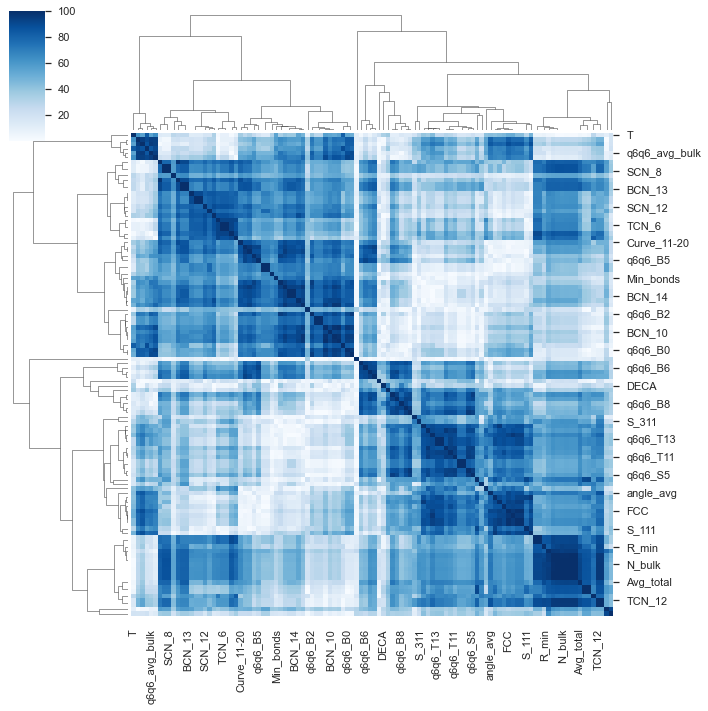

,T,N_total,N_bulk,N_surface,Volume,R_min,R_max,R_diff,R_avg,R_std,...,q6q6_S2,q6q6_S3,q6q6_S4,q6q6_S5,q6q6_S6,q6q6_S7,q6q6_S8,q6q6_S9,q6q6_S10,q6q6_S11
T,100.000000,1.408870,0.417286,4.258358,1.408092,7.202198,4.882562,9.967371,0.551488,19.078795,...,33.002102,14.393304,10.073984,21.617497,36.474398,50.562197,43.933212,47.902759,45.580027,41.168703
N_total,1.408870,100.000000,99.948752,99.644017,99.999781,93.224533,95.039665,57.872062,99.918804,44.679485,...,57.651060,60.186980,56.008111,56.821345,57.859011,61.033800,58.813871,49.599297,55.164613,45.055723
N_bulk,0.417286,99.948752,100.000000,99.353099,99.949038,93.923985,94.373885,56.269958,99.820974,43.108456,...,57.264083,59.727837,55.612643,56.276554,57.405436,60.594476,58.798962,49.405487,54.486629,44.209744
N_surface,4.258358,99.644017,99.353099,100.000000,99.643559,90.813090,96.388219,62.023975,99.690179,48.856628,...,58.456419,61.327029,57.166892,58.397714,59.198796,62.243470,59.001895,50.323595,57.176212,47.395612
Volume,1.408092,99.999781,99.949038,99.643559,100.000000,93.225854,95.037549,57.868717,99.918773,44.677352,...,57.649569,60.186834,56.010652,56.822613,57.859758,61.034677,58.818701,49.604559,55.165442,45.051124
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
q6q6_S7,50.562197,61.033800,60.594476,62.243470,61.034677,52.757213,55.830800,31.080378,60.076674,36.703444,...,3.648082,30.400052,55.308357,74.486963,88.322039,100.000000,91.457960,87.096780,92.042094,78.622583
q6q6_S8,43.933212,58.813871,58.798962,59.001895,58.818701,50.356452,54.352735,31.962014,58.337858,38.836264,...,5.531528,34.274500,62.349852,75.600337,87.412197,91.457960,100.000000,88.814495,85.961086,66.180261
q6q6_S9,47.902759,49.599297,49.405487,50.323595,49.604559,42.945708,46.602014,28.648036,49.237370,40.250797,...,14.241618,13.307956,43.762990,58.489192,73.509972,87.096780,88.814495,100.000000,85.643125,53.890932
q6q6_S10,45.580027,55.164613,54.486629,57.176212,55.165442,45.286585,51.983268,31.545207,54.385124,35.818748,...,4.578785,31.899788,57.361368,75.946262,89.002165,92.042094,85.961086,85.643125,100.000000,78.489043


In [65]:
sns.set()
correlacionados = X.corr(method='spearman').abs().mul(100).astype(float)
plt.figure(figsize=(5,5))
cmap = sns.diverging_palette(h_neg=210, h_pos=350, s=90, l=50, as_cmap=True)
cg = sns.clustermap(data = correlacionados, cmap='Blues', metric='correlation')
#cg = sns.clustermap(data = correlated, cmap='Blues', metric='correlation', annot =False, fmt='1g')
plt.setp(cg.ax_heatmap.yaxis.get_majorticklabels(), rotation=0)

plt.savefig('fig/correlation_matrix_{}.png'.format(prefix), dpi=300, bbox_inches='tight')
plt.show()
correlacionados

In [66]:
# print correlated features
for c1 in feature_names:
  for c2 in feature_names:
    if c1 != c2 and correlacionados[c1][c2] > 95:
        print(c1, c2)

N_total N_bulk
N_total N_surface
N_total Volume
N_total R_max
N_total R_avg
N_total TCN_12
N_total BCN_12
N_total N_bonds
N_bulk N_total
N_bulk N_surface
N_bulk Volume
N_bulk R_avg
N_bulk TCN_12
N_bulk BCN_12
N_bulk N_bonds
N_surface N_total
N_surface N_bulk
N_surface Volume
N_surface R_max
N_surface R_avg
N_surface TCN_12
N_surface BCN_12
N_surface N_bonds
Volume N_total
Volume N_bulk
Volume N_surface
Volume R_max
Volume R_avg
Volume TCN_12
Volume BCN_12
Volume N_bonds
R_max N_total
R_max N_surface
R_max Volume
R_max R_avg
R_avg N_total
R_avg N_bulk
R_avg N_surface
R_avg Volume
R_avg R_max
R_avg TCN_12
R_avg BCN_12
R_avg N_bonds
TCN_4 SCN_4
TCN_5 SCN_5
TCN_6 SCN_6
TCN_7 SCN_7
TCN_8 SCN_8
TCN_9 SCN_9
TCN_10 SCN_10
TCN_12 N_total
TCN_12 N_bulk
TCN_12 N_surface
TCN_12 Volume
TCN_12 R_avg
TCN_12 BCN_12
TCN_12 N_bonds
TCN_13 BCN_13
TCN_14 BCN_14
TCN_15 BCN_15
BCN_12 N_total
BCN_12 N_bulk
BCN_12 N_surface
BCN_12 Volume
BCN_12 R_avg
BCN_12 TCN_12
BCN_12 N_bonds
BCN_13 TCN_13
BCN_14 TCN_14
BC

In [67]:
X_scalado = StandardScaler().fit_transform(X)
y_scalado =  StandardScaler().fit_transform(y)

X_train, X_test, y_train, y_test = train_test_split(X_scalado, y_scalado, test_size=0.2, random_state=42)

In [70]:
lista=["LinearRegression", "Ridge", "KernelRidge" ]
for model, modelParams in models.items():
        if model in lista:
            modeling_scoring(modelParams[0], modelParams[1], X_scalado, y_scalado, prefix )

LinearRegression()
Best Hyperparameters: {'copy_X': True, 'fit_intercept': True}
Best Score: 0.9466894593106947

	Training time: 2.000s
	Prediction time: 0.000s

	R^2 score: -5.761624657762161e+16
	MAE score: 8474973.2691
	MSE score: 5.746013547740423e+16
	RMSE score: 239708438.4777
	under:  5.761624657762161e+16
	over:  0.053300000000000014
	MAPE score: 50.5264
File exist
Ridge()
Best Hyperparameters: {'alpha': 0.1, 'fit_intercept': False, 'max_iter': 100, 'random_state': 0, 'solver': 'auto'}
Best Score: 0.9470956886524993

	Training time: 1.000s
	Prediction time: 0.000s

	R^2 score: 0.9518
	MAE score: 0.1502
	MSE score: 0.048
	RMSE score: 0.2192
	under:  0.04820000000000002
	over:  0.05289999999999995
	MAPE score: 48.3993
File exist
KernelRidge()
Best Hyperparameters: {'alpha': 0.1, 'degree': 3, 'gamma': 0.01, 'kernel': 'rbf'}
Best Score: 0.9701550342429874

	Training time: 18.000s
	Prediction time: 0.000s

	R^2 score: 0.9765
	MAE score: 0.0903
	MSE score: 0.0234
	RMSE score: 0.1531


In [71]:
models_info = pd.read_csv(f"data/model_info/model_info_{prefix}.csv")
models_info

,model_name,data_set,N,HyperParam,Best Score,R2,MAE,MSE,RMSE,MAPE,under,over
0,LinearRegression,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930652,9.363000e-01,1.862000e-01,6.350000e-02,2.520000e-01,82.8260,6.370000e-02,0.0693
1,Ridge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.930569,9.365000e-01,1.850000e-01,6.330000e-02,2.517000e-01,64.2242,6.350000e-02,0.0694
2,KernelRidge,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.961578,9.664000e-01,1.172000e-01,3.350000e-02,1.829000e-01,77.2667,3.360000e-02,0.0384
3,Lasso,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.912147,9.206000e-01,2.133000e-01,7.920000e-02,2.814000e-01,531.4094,7.940000e-02,0.0879
4,ElasticNet,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.924987,9.322000e-01,1.929000e-01,6.760000e-02,2.599000e-01,575.1203,6.780000e-02,0.0750
5,DecisionTreeRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.693131,7.344000e-01,3.966000e-01,2.648000e-01,5.146000e-01,216.4866,2.656000e-01,0.3069
6,ExtraTreeRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.913022,9.355000e-01,1.215000e-01,6.430000e-02,2.537000e-01,801.7072,6.450000e-02,0.0870
7,RandomForestRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.967342,9.796000e-01,7.800000e-02,2.030000e-02,1.426000e-01,698.2466,2.040000e-02,0.0327
8,KNeighborsRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.944486,9.608000e-01,1.178000e-01,3.910000e-02,1.978000e-01,92.7476,3.920000e-02,0.0555
9,GradientBoostingRegressor,total,45,"{'cv': RepeatedKFold(n_repeats=3, n_splits=5, ...",0.961967,9.691000e-01,1.111000e-01,3.080000e-02,1.756000e-01,778.5616,3.090000e-02,0.0380


Si vemos los ultimos 3 chau